### 2. Data Preparation and Analysis
- This is the second notebook which contains componets 2 and 3 of the assignment.

- I will load the saved dataset (raw NBA data) from Part 1 into appropriate data structures, I have chosen to use pandas data frames as the main data structure using dictionaries for intermediary data parsing steps.

- I will apply any data preprocessing steps that might be required to clean, filter or transform the dataset before analysis.

- I will Analyse, characterise, and summarise the cleaned dataset, using tables and visualisations where appropriate.

- I would like to find what features that indicate better player productivity offensively and defensively as well as detractors.

- Then I would like to find a way to visualise the top players and their stats for making an overall strongly positive contribution to their respective teams, excluding players that fail in key defensive/offensive areas (turnovers, fouls, points, blocks, steals and assists) or overall productivity features like (plusMinus score, minutes played etc).

- Load packages and libraries

In [1]:
import http.client
import json
from pathlib import Path
import pandas as pd
from scipy.stats import shapiro

from datetime import datetime, date

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import plotly.io as pio

from IPython.display import HTML, Javascript, display

# !pip install plotly 
# !pip install cufflinks 
# !pip install chart_studio
# !pip install seaborn --upgrade
# !pip install print-versions # works for python >= 3.8
# !pip install pypalettes

from pypalettes import load_cmap
import seaborn as sns
import cufflinks as cf
import chart_studio.plotly as py
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
import plotly.io as pio
from plotly.offline import init_notebook_mode

- Basic notebook configurations for rendering plots

In [2]:
# magic function, renders matplotlib figures in notebook / inline
# %matplotlib inline 
%matplotlib 
pd.options.plotting.backend = "plotly"
# pio.renderers.default = 'notebook'
pio.renderers.default = "notebook_connected"
init_notebook_mode(connected=False)
cf.go_offline()

Using matplotlib backend: module://matplotlib_inline.backend_inline


In [3]:
import types
def imports():
    for name, val in globals().items():
        if isinstance(val, types.ModuleType):
            yield val.__name__
list(imports())

['builtins',
 'builtins',
 'json',
 'sys',
 'http',
 'pandas',
 'matplotlib',
 'matplotlib.pyplot',
 'matplotlib.ticker',
 'plotly.io',
 'seaborn',
 'cufflinks',
 'chart_studio.plotly',
 'plotly.express',
 'plotly.graph_objects',
 'plotly.figure_factory',
 'types']

In [4]:
from print_versions import print_versions

print_versions(globals())

json==2.0.9
ipykernel==6.28.0
pandas==2.2.2
scipy==1.13.1
matplotlib==3.9.2
pypalettes==0.1.4
seaborn==0.13.2
cufflinks==0.17.3
plotly==5.24.1


In [5]:
import sys
print(sys.executable)
print(sys.version)
print(sys.version_info)

/opt/anaconda3/bin/python
3.12.7 | packaged by Anaconda, Inc. | (main, Oct  4 2024, 08:28:27) [Clang 14.0.6 ]
sys.version_info(major=3, minor=12, micro=7, releaselevel='final', serial=0)


- Set file read configurations

In [6]:
# directory for raw data storage
dir_raw = Path("raw")
# directory for storing clean pre-processed data
dir_data = Path("data")
# make sure it exists
dir_data.mkdir(parents=True, exist_ok=True)

## Data Preprocessing

In [7]:
# init config, runtime variables and counters
teams = ["atlanta hawks", "boston celtics", "brooklyn nets", "charlotte hornets", "chicago bulls", 
         "cleveland cavaliers", "dallas mavericks", "denver nuggets", "detroit pistons", "golden state warriors", 
         "houston rockets", "indiana pacers", "la clippers", "los angeles lakers", "memphis grizzlies", "miami heat", 
         "milwaukee bucks", "minnesota timberwolves", "new orleans pelicans", "new york knicks", "oklahoma city thunder",
         "orlando magic", "philadelphia 76ers", "phoenix suns", "portland trail blazers", "sacramento kings", 
         "san antonio spurs", "toronto raptors", "utah jazz", "washington wizards"]
seasons = [2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]

player_files = {}
for team_name in teams:
    player_files[team_name] = []
    
stats_files = {}
for team_name in teams:
    for season in seasons:
        stats_files[team_name + ' ' + str(season)] = []

stats_rec_cnt = 0
player_indiv_cnt = 0

debug_mode = False

In [8]:
# iterate through raw data on disk
for fpath in dir_raw.iterdir():
    if fpath.suffix == ".json":
        with open(fpath, "r") as fin:
            jdata = fin.read()
            data = json.loads(jdata)
            
            # parse the filename
            parts = fpath.stem.split("_")
            
            # set season, team and file type
            team = ''
            season = ''
            data_type = parts[-1]
            if (len(parts) >= 5 and len(parts[3]) == 4):
                team = parts[0] + ' ' + parts[1] + ' ' + parts[2]
                season = parts[3]
            else:
                team = parts[0] + ' ' + parts[1]
                season = parts[2]
            
            # add data to dict before merging
            if (team in teams):
                number_records = len(data['response'])
                if debug_mode:
                    print("Reading data for the %s for season %s with data type %s with %s records" % (team, season, data_type, number_records))
                if (data_type == 'players'):   
                    player_files[team] = pd.DataFrame.from_dict(data["response"])
                    player_indiv_cnt += number_records
                elif (data_type == 'stats'):
                    stats_files[team + ' ' + str(season)] = pd.DataFrame.from_dict(data["response"])
                    stats_rec_cnt += number_records
                else:
                    print('Invalid data type: ', data_type)
                
print("Finished reading %s player statistics records" % (stats_rec_cnt))
print("Finished reading %s individual player records" % (player_indiv_cnt))

Finished reading 310297 player statistics records
Finished reading 7382 individual player records


## Data Parsing and Merging

- Define function to get player age from DOB

In [9]:
# calculate player age from date of birth (DOB)
def get_player_age(birth_date):
    if (birth_date != '' and birth_date is not None):
        dob = datetime.strptime(birth_date, '%Y-%m-%d').date()
        today = date.today()
        return today.year - dob.year - ((today.month, today.day) < (dob.month, dob.day))
    else:
        return None

- Concatenate all data from player statitics files

In [10]:
df_player_stats = pd.concat(stats_files)

- Concatenate all data from individual player files

In [11]:
df_player_details = pd.concat(player_files)

## Data Verification
- Assert number of records loaded is as expected

In [12]:
print(df_player_stats.shape)
# 309697 (18553 for 6x teams 21-23) is total number of player stats records
df_player_stats.shape[0] == 310297

(310297, 25)


True

In [13]:
print(df_player_details.shape)
df_player_details.shape[0] == 864

(864, 10)


True

- 716 still high (possible dupes) as there are 450 ish players in the NBA per season
- Player details data in parts is duplicated from season to season so have kept the main information

- Normalise nested JSON fields and extract the features needed for merging and analysis
- Drop duplicate data and nested JSON fields when ready

In [14]:
# Normalize nested JSON objects for player game statistics
df_player = pd.json_normalize(df_player_stats['player'])# pull player_id and merge first/last name for player_name
df_team = pd.json_normalize(df_player_stats['team']) # pull team_id, team_code and name (drop team name index)
df_game = pd.json_normalize(df_player_stats['game']) # Extract game ID

# Normalize nested JSON objects for player details
df_birth = pd.json_normalize(df_player_details['birth'])# pull country and DOB
df_height = pd.json_normalize(df_player_details['height'])# pull height in mteres and merge feets/inches into ft_height
df_leagues = pd.json_normalize(df_player_details['leagues'])# pull standard.active	standard.jersey	standard.pos
df_nba = pd.json_normalize(df_player_details['nba'])# pull pro and start for international player insights ?
df_weight = pd.json_normalize(df_player_details['weight'])# pull kilograms and pounds

In [15]:
# Extract normalized data to player stats DF
df_player_stats = df_player_stats.reset_index(drop=False)

del df_player_stats['level_1']
df_player_stats['season'] = df_player_stats['level_0'].apply(lambda x: x.split(' ')[-1])
del df_player_stats['level_0']

df_player_stats['player_id'] = df_player['id']
df_player_stats['player_name'] = df_player['firstname'] + ' ' + df_player['lastname']

del df_player_stats['player']

df_player_stats['team_code'] = df_team['code']
df_player_stats['team_name'] = df_team['name']
df_player_stats['team_id'] = df_team['id']

del df_player_stats['team']

df_player_stats['game_id'] = df_game['id']

del df_player_stats['game']

df_player_stats['min'] = pd.to_numeric(df_player_stats['min'], errors='coerce')
df_player_stats['plusMinus'] = pd.to_numeric(df_player_stats['plusMinus'], errors='coerce')

In [16]:
# Extract normalized data to player details DF
df_player_details = df_player_details.reset_index(drop=True)

df_player_details['country'] = df_birth['country']
df_player_details['DOB'] = df_birth['date']

df_player_details['age'] = df_player_details['DOB'].apply(get_player_age)
df_player_details['age'] = df_player_details['age'].fillna(0).astype('int')
del df_player_details['birth']

df_player_details['feet'] = df_height['feets'] + '\"' + df_height['inches']
df_player_details['meters'] = df_height['meters']
df_player_details['meters'] = pd.to_numeric(df_player_details['meters'], errors='coerce')
df_player_details['meters'] = df_player_details['meters'].apply(lambda x: round(float(x), 2) if x != None else x)
del df_player_details['height']

df_player_details['position'] = df_leagues['standard.pos']
df_player_details['active'] = df_leagues['standard.active']
df_player_details['jersey_number'] = df_leagues['standard.jersey']
del df_player_details['leagues']

df_player_details['years_pro'] = df_nba['pro']
df_player_details['rookie_year'] = df_nba['start']
del df_player_details['nba']

df_player_details['pounds'] = df_weight['pounds']
df_player_details['pounds'] = df_player_details['pounds'].astype('Int16')
del df_player_details['weight']

In [17]:
df_player_stats.shape # verify record count is the same and new column count

(310297, 29)

### Merge player performance statistics and individual player information

In [18]:
# merge data frames (player game statistics and player details)
df = pd.merge(df_player_stats, df_player_details, how='left', left_on='player_id', right_on='id')

- View features available for analysis

In [19]:
df.columns

Index(['assists', 'blocks', 'comment', 'defReb', 'fga', 'fgm', 'fgp', 'fta',
       'ftm', 'ftp', 'min', 'offReb', 'pFouls', 'plusMinus', 'points', 'pos',
       'steals', 'totReb', 'tpa', 'tpm', 'tpp', 'turnovers', 'season',
       'player_id', 'player_name', 'team_code', 'team_name', 'team_id',
       'game_id', 'affiliation', 'college', 'firstname', 'id', 'lastname',
       'country', 'DOB', 'age', 'feet', 'meters', 'position', 'active',
       'jersey_number', 'years_pro', 'rookie_year', 'pounds'],
      dtype='object')

- Set DataFrame index to season / year

In [20]:
# set season (year) as main DF index to allow for time series analysis of player data
df = df.reset_index().set_index('season')
df.index = pd.to_datetime(df.index, format='%Y').to_period('Y')
df = df.sort_index(axis=0)

## Data Analysis

- Set font size
- Define function to create time series plot
- Define function to summarise top players for a given performance statistic (i.e. Points scored, Blocks, Steals, Rebounds, Field Goal Percentage etc.)
- Define function to highlight cell greater or equal threshold of 0.7 and less than 1

In [21]:
fontsize=22

# convenience function for time series plots
def create_ts_plot(data, title, ylabel, color="navy", rhs_vals=None):
    # create a time series plot
    pd.options.plotting.backend = "matplotlib"
    ax = data.plot(figsize=(9, 4.3), legend=False, lw=2, zorder=3, color=color)
    plt.title(title, fontsize=fontsize-1)
    plt.ylabel(ylabel)
    plt.xlabel(None)
    ax.xaxis.grid(False)
    ax.yaxis.grid(True)
    return ax

# convenience function to aggregate top players by a given statistic or feature
def summary_top_players(grp, stat,  sort_by = 'mean', results = 10):
    df[stat] = pd.to_numeric(df[stat], errors='coerce')# handle nans and plusMinus values which are char in format ''+/-[0-9]*'
    df_aggs = round(df.groupby([grp])[stat].agg(['mean', 'sum']), 2)
    return df_aggs.sort_values(by=sort_by, ascending=False).head(results)

# convenience method to highlight data frame cell lime green
def highlighter(cell_value, thresh_lower = 0.7, thresh_upper = 0.99):
    if cell_value < thresh_upper and cell_value >= thresh_lower:
        return "background-color: #32CD32"
    elif cell_value == 1:
        return "background-color: yellow"

- Convert pounds feature to numeric column and get mean value

In [22]:
df['pounds'] = pd.to_numeric(df['pounds'])
print("Average player weight %s lbs." % round(df['pounds'].mean(skipna = True), 2))

Average player weight 220.04 lbs.


- Convert meters feature to numeric column and get mean value

In [23]:
df['meters'] = pd.to_numeric(df['meters'])
round(df['meters'].mean(skipna = True), 2)
print("Average player height %s meters" % round(df['meters'].mean(skipna = True), 2))

Average player height 1.99 meters


- Check is there a correlation between player weight in lbs and height in meters

In [24]:
df[['pounds', 'meters']].corr()

,pounds,meters
pounds,1.000000,0.803011
meters,0.803011,1.000000


- There is a strong correlation between player weight and height
- Taller players are more likely to be heavier, However, there is still room for some outliers to this trend
- Lets visualise this as an interactive scatter plot

In [25]:
df.plot('pounds', 'meters', 'scatter')

- I think this is a good approach to find some important features in this dataset related to player performance
- I am now going to look at the correlation table for all numeric columns
- Then I will apply a cell highlighter for interesting fields in the correlation matrix with a strong relationship or corerelation (over 70%)

In [26]:
numeric_cols = ['assists', 'blocks', 'defReb', 'fga', 'fgm', 'fgp', 'fta', 'ftm', 'ftp', 'offReb', 'pFouls', 
                'points', 'steals', 'totReb', 'tpa', 'tpm', 'tpp', 'turnovers', 'age', 'meters', 'min', 'plusMinus',
                'pounds', 'years_pro', 'rookie_year', 'jersey_number']

df_corr_c = df[numeric_cols].corr()

df_corr_c.style.applymap(highlighter)

/var/folders/90/vm59v1w170n_62vbrwvd6m100000gn/T/ipykernel_68283/1018646265.py:7: FutureWarning:

Styler.applymap has been deprecated. Use Styler.map instead.



,assists,blocks,defReb,fga,fgm,fgp,fta,ftm,ftp,offReb,pFouls,points,steals,totReb,tpa,tpm,tpp,turnovers,age,meters,min,plusMinus,pounds,years_pro,rookie_year,jersey_number
assists,1.000000,0.079674,0.340091,0.549099,0.484309,0.196846,0.371088,0.376209,0.312083,0.097848,0.246261,0.506446,0.318400,0.302775,0.389828,0.302052,0.205480,0.454099,0.129801,-0.255730,0.565309,0.159643,-0.168554,0.226554,0.106750,-0.151803
blocks,0.079674,1.000000,0.338754,0.197077,0.222462,0.199579,0.193670,0.161519,0.141947,0.281917,0.215278,0.209967,0.113104,0.370628,0.022500,0.016499,0.004088,0.142663,0.078543,0.254293,0.237809,0.086510,0.247685,0.114555,0.071519,0.010586
defReb,0.340091,0.338754,1.000000,0.512211,0.511465,0.332998,0.412004,0.371813,0.324649,0.422380,0.369957,0.506126,0.239144,0.940685,0.229672,0.182249,0.119364,0.378101,0.140969,0.258058,0.565943,0.163447,0.311019,0.231282,0.122702,-0.019374
fga,0.549099,0.197077,0.512211,1.000000,0.897110,0.329057,0.539575,0.539328,0.468027,0.290146,0.385781,0.897545,0.361883,0.509453,0.706782,0.563559,0.318338,0.496357,0.161658,-0.128402,0.793665,0.081943,-0.061178,0.272690,0.153435,-0.152532
fgm,0.484309,0.222462,0.511465,0.897110,1.000000,0.558955,0.514565,0.504767,0.437413,0.304874,0.366446,0.968090,0.328844,0.514382,0.564573,0.583729,0.397272,0.454488,0.153440,-0.030058,0.728927,0.181828,0.030691,0.255437,0.146645,-0.118146
fgp,0.196846,0.199579,0.332998,0.329057,0.558955,1.000000,0.230639,0.206035,0.259237,0.237477,0.304647,0.516796,0.182438,0.349489,0.149461,0.298917,0.420949,0.220828,0.091801,0.130794,0.259265,0.168993,0.148834,0.134968,0.080529,-0.016701
fta,0.371088,0.193670,0.412004,0.539575,0.514565,0.230639,1.000000,0.952797,0.629571,0.261029,0.275996,0.663937,0.241450,0.420133,0.268837,0.203999,0.112166,0.382960,0.120447,0.044297,0.487887,0.086837,0.107791,0.218717,0.108114,-0.075985
ftm,0.376209,0.161519,0.371813,0.539328,0.504767,0.206035,0.952797,1.000000,0.705450,0.205378,0.253955,0.673420,0.232656,0.367850,0.301125,0.231301,0.131425,0.372525,0.116325,-0.000060,0.478820,0.097521,0.054960,0.211806,0.101914,-0.080880
ftp,0.312083,0.141947,0.324649,0.468027,0.437413,0.259237,0.629571,0.705450,1.000000,0.186518,0.268580,0.546191,0.218099,0.323881,0.293053,0.230111,0.160326,0.302270,0.098488,-0.023459,0.433203,0.085218,0.009245,0.167465,0.088786,-0.069328
offReb,0.097848,0.281917,0.422380,0.290146,0.304874,0.237477,0.261029,0.205378,0.186518,1.000000,0.268897,0.271791,0.133496,0.704857,-0.045877,-0.050481,-0.052322,0.182752,0.066980,0.330213,0.275649,0.040050,0.376169,0.114056,0.064365,0.037032


- This is still a bit awkward to decode so I am going to list the same info as a list with the feature pairs that have the strongest correlation prioritiesd to the top of the list

In [27]:
df_corr_c = df[numeric_cols].corr().abs().unstack().sort_values(ascending=False)
df_corr_c[(df_corr_c < 1) & (df_corr_c >= 0.7)]# exclude below 74% correlation and 100% for matching cols in corr matrix

fgm          points         0.968090
points       fgm            0.968090
ftm          fta            0.952797
fta          ftm            0.952797
totReb       defReb         0.940685
defReb       totReb         0.940685
rookie_year  age            0.899696
age          rookie_year    0.899696
points       fga            0.897545
fga          points         0.897545
             fgm            0.897110
fgm          fga            0.897110
tpm          tpa            0.825256
tpa          tpm            0.825256
pounds       meters         0.803011
meters       pounds         0.803011
min          fga            0.793665
fga          min            0.793665
points       min            0.743744
min          points         0.743744
             fgm            0.728927
fgm          min            0.728927
tpp          tpm            0.707594
tpm          tpp            0.707594
tpa          fga            0.706782
fga          tpa            0.706782
ftm          ftp            0.705450
f

- We can see 'points' (Points scored) and field goals made ('fgm') have the strongest correlation which is interesting.
- We can see other fields of interest that have a strong correlation with 'points' are 'fga' (Field Golas Attempted), and 'min' (Minutes Played)
- Rebounding related fields have a strong relationship (defensive, offensive and total rebounds) which makes sense
- Weight and Height, Field Goal related, Three Pointer features (tpm, tpa), Free Throws (ftp, fta, ftm), and age / years playing professional all figure as field pairs/tuples that have strong correlation which is expected.
- A player that scores a lot of field goals tend to score more points, more so than a higher scoring rate of free throws or three pointers
- On the other side, if we look back at the correlation matrix: Blocks, Steals and Assists are often stand alone performance statistics that to not seem to have a strong correlation with any other feature
- This is also true for categories that have a negative aspect to player performance such as personal founls (pFouls) and turnovers.
- PlusMinus is a very prominent feature as it measures the positive or negative impact and contribution a player has for his team for a given game while on court, over the course of a season this is a telling statistic.

- I would like to view a time series line plot of the avergae player weight per season

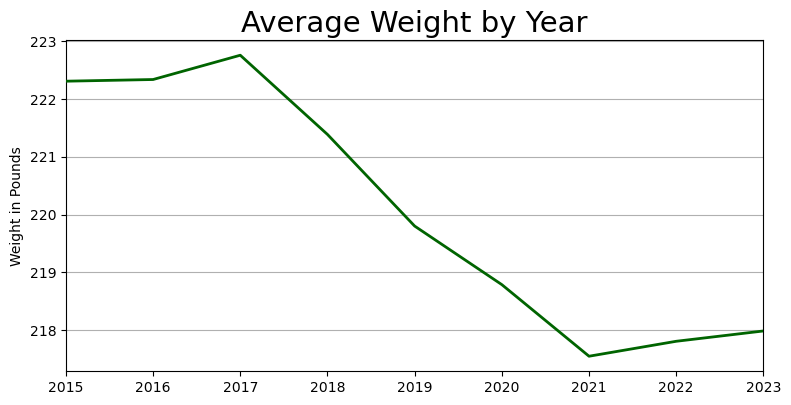

In [28]:
df_weight = df.copy()
df_weight.index = df_weight.index.to_timestamp()

df_weight = df_weight['pounds'].resample("1YE").mean()
create_ts_plot(df_weight, "Average Weight by Year", "Weight in Pounds", "darkgreen");

- From this plot it appears the players are lighter overall since 2015 and trending down in weight by 5/6 lbs from 2015 - 2023
- Lets verify this by checking the mean weight of players per the 2015 season data and again for 2023

In [29]:
avg_weight_2015 = round(df[df.index == '2015']['pounds'].mean(), 2)
print("Average weight for 2015: %s pounds" % avg_weight_2015)

Average weight for 2015: 222.31 pounds


In [30]:
avg_weight_2023 = round(df[df.index == '2023']['pounds'].mean(), 2)
print("Average weight for 2023: %s pounds" % avg_weight_2023)

Average weight for 2023: 217.99 pounds


In [31]:
print("Difference in weight from 2015 to 2023: %s lbs" % (round(avg_weight_2015 - avg_weight_2023, 2)))

Difference in weight from 2015 to 2023: 4.32 lbs


- Heaviest Players in the NBA from 2015-2023

In [32]:
df[['player_name', 'pounds', 'meters', 'feet']].reset_index(drop=True).sort_values(by=['pounds'], ascending=False).drop_duplicates()[0:5]

,player_name,pounds,meters,feet
77479,Boban Marjanovic,290,2.21,"7""3"
306389,Jusuf Nurkic,290,2.11,"6""11"
363308,Nikola Jokic,284,2.11,"6""11"
333045,Zion Williamson,284,1.98,"6""6"
281706,Joel Embiid,280,2.13,"7""0"


- Notably Zion Williamson is quite heavy for his height (under 2 meters)

- Lighest Players in the NBA from 2015-2023

In [33]:
df[['player_name', 'pounds', 'meters', 'feet']].reset_index(drop=True).sort_values(by=['pounds'], ascending=True).drop_duplicates()[0:5]

,player_name,pounds,meters,feet
245147,Tyrell Terry,160,1.88,"6""2"
333984,Isaiah Joe,165,1.93,"6""4"
272056,Xavier Moon,165,1.88,"6""2"
307900,Kyle Guy,167,1.85,"6""1"
370389,Bones Hyland,169,1.88,"6""2"


- View average height for players in 2017

In [34]:
print("Average height for players in 2017: %s meters" % round(df[df.index == '2017']['meters'].mean(), 3))

Average height for players in 2017: 1.998 meters


- View average height for players in 2021

In [35]:
print("Average height for players in 2021: %s meters" % round(df[df.index == '2021']['meters'].mean(), 3))

Average height for players in 2021: 1.99 meters


- I would like to view a time series line plot of the avergae player height per season to get a better idea of this data and trend

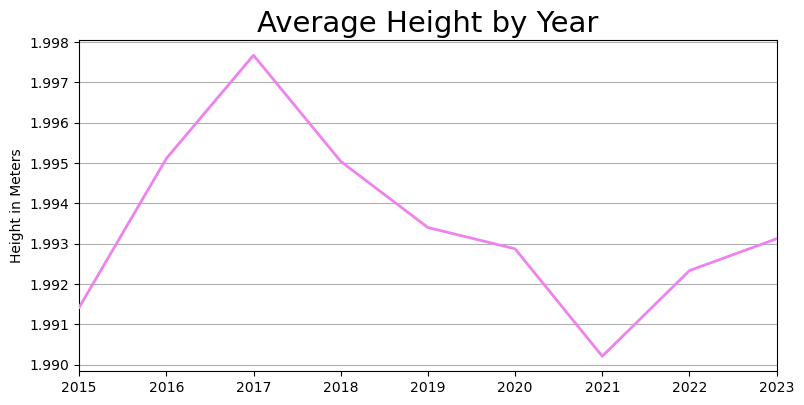

In [36]:
df_height = df.copy()
df_height.index = df_height.index.to_timestamp()

df_height = df_height['meters'].resample("1YE").mean()
create_ts_plot(df_height, "Average Height by Year", 
               "Height in Meters", "violet");

- As opposed to the trend in average player weight (trending down), the average player height has not varied much from 2015 - 2023. 
- The average height staying at 1.99 to 2 meters (6"6 in feet and inches).

- Next, lets get an idea of the distribution of total minutes played by NBA players from 2015-2023 
- I would like to know the if it is a normal distribution and are there any outliers

In [37]:
# create histogram visual
mins_played_summary = summary_top_players('player_name', 'min', results = 800)['sum']
h = mins_played_summary.hist(backend='plotly', labels=dict(index='Player Count', value='Minutes Played', 
                                                           variable='Total Minutes Played'))
h.layout.yaxis.title.text = 'Player Count'
h

- Not a bell shape or the expected normal distribution, we can confirm this with the Shapiro-Wilk test where we can reject the null hypothesis when p value is less than 0.05 and say the data does not come from a normal distribution

In [38]:
test_normality = shapiro(mins_played_summary)

print(test_normality)

ShapiroResult(statistic=0.8044021634587862, pvalue=5.456300342970356e-30)


In [39]:
is_not_normal_dist = (test_normality.pvalue < 0.05) and (test_normality.statistic > 0.8)
print("Can we reject the null hypothesis and say this is not a normal distribution (bell shaped): %s" % is_not_normal_dist)

Can we reject the null hypothesis and say this is not a normal distribution (bell shaped): True


- We can see most players fall into bins where they have played less than 5k minutes in this time (the majority have less than 500 mins playing time at a count of 340 players) 
- However, the distribution is right skewed distribution with a gap before a group of players that have between 7.5k and 10k approx. playing minutes in that time frame of 9 years, this may be due to playoff runs of teams that have smaller squads or players that seem to avoid injury more often than not.
- Lets view the players in this group, `Note`: It will be interesting if they end up in the group of players with the best team impact.

In [40]:
df_mins = summary_top_players('player_name', 'min', sort_by = 'sum', results = 20)
df_mins[df_mins['sum'] > 7500]
df_mins

,mean,sum
player_name,,
Taurean Prince,24.66,13612.0
Domantas Sabonis,34.65,11158.0
Norman Powell,25.90,10569.0
Nikola Vucevic,33.47,10444.0
Pascal Siakam,34.87,10322.0
Alex Caruso,25.14,10257.0
Josh Hart,31.86,10196.0
Kevin Durant,36.11,9244.0
Jarrett Allen,32.31,9048.0


- Pascal Siakam is the only player with more than 10k mins played. He was heavily relied upon especially during torontos championship run in 2019 along with Kyle Lowry.
- This is notable because that was a first NBA championship for Toronto / Canada (help to grow the game beyond the USA).
- Keeping top players injury free was key for them more so than some heavyweight teams like warriors, lakers etc.
- Otherwise, while top players, the players listed here are mostly not huge names come the business end of the season and I do not expect to see these names in the final elite player group for the past 9 years.

- Lets view the top players in different stat groupings by average (mean is default sort order) or total (sum when specified in `sort_by` parameter) where appropriate.

In [41]:
summary_top_players('player_name', 'points', sort_by = 'sum', results=5)

,mean,sum
player_name,,
Kevin Durant,27.13,32884.0
Russell Westbrook,21.88,32210.0
Andre Drummond,12.87,26901.0
Kyrie Irving,24.32,26508.0
Evan Fournier,14.76,25899.0


In [42]:
summary_top_players('player_name', 'points', results=5)

,mean,sum
player_name,,
Luka Doncic,28.11,12396.0
Stephen Curry,27.25,18476.0
Kevin Durant,27.13,32884.0
James Harden,26.78,19897.0
Damian Lillard,26.36,17794.0


In [43]:
summary_top_players('player_name', 'assists', sort_by = 'sum', results=5)

,mean,sum
player_name,,
Russell Westbrook,8.78,12922.0
Kyle Lowry,6.42,8990.0
Eric Bledsoe,4.98,7404.0
James Harden,8.76,6506.0
Kevin Durant,5.16,6250.0


In [44]:
summary_top_players('player_name', 'assists', results=5)

,mean,sum
player_name,,
Trae Young,9.20,4288.0
Russell Westbrook,8.78,12922.0
James Harden,8.76,6506.0
John Wall,8.64,6204.0
Tyrese Haliburton,8.57,2228.0


In [45]:
summary_top_players('player_name', 'fgp', sort_by = 'sum', results=5)

,mean,sum
player_name,,
JaVale McGee,53.20,145542.0
Mason Plumlee,58.54,126276.3
Andre Drummond,53.20,111251.1
Taurean Prince,40.88,91234.0
Doug McDermott,44.47,89660.7


In [46]:
summary_top_players('player_name', 'ftp', sort_by = 'sum', results=5)# free throw percentage

,mean,sum
player_name,,
Gordon Hayward,67.98,105230.4
Kevin Durant,85.54,103669.2
Norman Powell,49.66,100863.6
Russell Westbrook,67.41,99221.2
Evan Fournier,56.15,98536.8


In [47]:
summary_top_players('player_name', 'tpp', sort_by = 'sum', results=6)# three-point percentage

,mean,sum
player_name,,
Taurean Prince,33.32,74375.6
Doug McDermott,34.98,70516.2
Norman Powell,31.53,64031.1
Evan Fournier,35.47,62258.4
Alec Burks,32.60,57601.2
Gordon Hayward,35.18,54451.2


In [48]:
summary_top_players('player_name', 'offReb', sort_by = 'sum', results=5)# offensive rebounds

,mean,sum
player_name,,
Andre Drummond,4.01,8385.0
Steven Adams,3.95,5062.0
Mason Plumlee,2.15,4641.0
JaVale McGee,1.40,3836.0
Taj Gibson,1.88,3435.0


In [49]:
summary_top_players('player_name', 'defReb', sort_by = 'sum', results=5)# defensive rebounds

,mean,sum
player_name,,
Andre Drummond,8.29,17340.0
Nikola Vucevic,8.21,11418.0
Mason Plumlee,4.79,10335.0
Russell Westbrook,6.82,10038.0
DeAndre Jordan,6.95,9282.0


In [50]:
summary_top_players('player_name', 'totReb', results=5)# Total rebounds by average

,mean,sum
player_name,,
Andre Drummond,12.30,25725.0
Rudy Gobert,12.11,8731.0
Giannis Antetokounmpo,10.71,7863.0
Joel Embiid,10.70,5480.0
Karl-Anthony Towns,10.62,6678.0


In [51]:
summary_top_players('player_name', 'totReb', sort_by = 'sum', results=5)# Total rebounds by total/sum

,mean,sum
player_name,,
Andre Drummond,12.30,25725.0
Mason Plumlee,6.94,14976.0
Nikola Vucevic,10.45,14530.0
DeAndre Jordan,9.44,12612.0
Russell Westbrook,8.41,12376.0


In [52]:
summary_top_players('player_name', 'blocks', sort_by = 'sum', results=5)# blocked shots

,mean,sum
player_name,,
JaVale McGee,0.97,2644.0
Andre Drummond,1.15,2409.0
Mason Plumlee,0.82,1764.0
Kevin Durant,1.27,1540.0
Rudy Gobert,2.07,1495.0


In [53]:
summary_top_players('player_name', 'blocks', results=6)# blocked shots by average

,mean,sum
player_name,,
Selom Mawugbe,4.50,9.0
Victor Wembanyama,3.45,224.0
Chet Holmgren,2.46,177.0
Walker Kessler,2.39,334.0
Myles Turner,2.19,1374.0
Anthony Davis,2.16,1362.0


- Notable inclusions here for average blocked shots instead of total/sum blocked shots in 9 years (Highly touted rookies Victor Wenbamyama & Chet Holmgren)

In [54]:
summary_top_players('player_name', 'steals', sort_by = 'sum', results=5)

,mean,sum
player_name,,
Andre Drummond,1.30,2715.0
Russell Westbrook,1.50,2214.0
Eric Bledsoe,1.34,2001.0
Robert Covington,1.53,1886.0
Kyle Lowry,1.30,1818.0


In [55]:
summary_top_players('player_name', 'fgm', sort_by = 'sum', results=5)

,mean,sum
player_name,,
Russell Westbrook,7.96,11712.0
Kevin Durant,9.53,11554.0
Andre Drummond,5.35,11178.0
Nikola Vucevic,7.64,10616.0
Kyrie Irving,9.04,9856.0


In [56]:
summary_top_players('player_name', 'fgm', results=6)

,mean,sum
player_name,,
DMitrik Trice,10.00,10.0
LeBron James,9.90,7039.0
Luka Doncic,9.58,4223.0
Giannis Antetokounmpo,9.57,7025.0
Kevin Durant,9.53,11554.0
Anthony Davis,9.07,5732.0


In [57]:
summary_top_players('player_name', 'fga', results=5)

,mean,sum
player_name,,
Luka Doncic,20.39,8990.0
Donovan Mitchell,19.36,10514.0
Stephen Curry,19.14,12976.0
Damian Lillard,19.03,12843.0
LeBron James,18.93,13456.0


In [58]:
summary_top_players('player_name', 'fga', sort_by='sum', results=5)

,mean,sum
player_name,,
Russell Westbrook,18.14,26704.0
Kevin Durant,18.38,22282.0
Nikola Vucevic,15.64,21742.0
Evan Fournier,12.04,21129.0
Andre Drummond,10.05,21021.0


- Lets look at fgm (Field Goals Made) a bit closer and sort by mean instead of sum for aggregation type, as it has strong correlation with points scored

In [59]:
df_field_goals_made = summary_top_players('player_name', 'fgm')
df_field_goals_made = df_field_goals_made[df_field_goals_made['sum'] > 5000]
df_field_goals_made

,mean,sum
player_name,,
LeBron James,9.90,7039.0
Giannis Antetokounmpo,9.57,7025.0
Kevin Durant,9.53,11554.0
Anthony Davis,9.07,5732.0
Stephen Curry,9.05,6134.0
Kyrie Irving,9.04,9856.0


- This is promising as I would expect these players to appear in the elite player group at the end of the analysis
- Lets look at plusMinus score which is a good starting point to see players that contribute well to the team but maybe not in the top 5 of specific areas like points or rebounds.

In [60]:
summary_top_players('player_name', 'plusMinus', sort_by = 'sum')

,mean,sum
player_name,,
Kevin Durant,7.02,8510.0
Stephen Curry,7.75,5256.0
Danny Green,3.85,5004.0
Kyle Lowry,3.53,4946.0
Steven Adams,3.54,4536.0
Kyrie Irving,4.01,4368.0
Draymond Green,6.03,4303.0
Pascal Siakam,3.03,3814.0
Paul Millsap,2.26,3585.0


- We can see players like Kyle Lowry, Chris Paul and Draymond Green figure here and contribute well over time while their average/mean is not at the same level as Stephen Curry or Kevin Durant

- I would like to see the countries represented in the NBA over the past 9 years
- I want to visualise this information by the total minutes played per country

In [61]:
df_country_grp = df.loc[~((df['min'] == 0) | (df['min'].isna()))]

country_grp = df_country_grp.groupby('country')['min'].agg({'sum'}).sort_values('sum', ascending=False)
country_grp

,sum
country,
USA,731504.0
Canada,21519.0
France,15989.0
Australia,14739.0
Germany,14322.0
Cameroon,14177.0
Lithuania,11158.0
Montenegro,10474.0
Croatia,9141.0


- The Bahamas shooting above its weight here (by way of population per Country) with the likes of Buddy Hield & Deandre Ayton

In [62]:
print("The number of countries with representation in the NBA over the last 9 years is: %s" % len(country_grp))# Count of countries represented

The number of countries with representation in the NBA over the last 9 years is: 36


- Lets remove the USA because as expected they are well represented in NBA basketball, far more than any other country

In [63]:
# remove USA (heavily weighted towards players from USA)
hbar = country_grp[1:].plot(backend='plotly', kind='bar', labels = dict(variable='Minutes Played', 
                                                                        value='Total Minutes Played', index='Country'))
hbar.layout.yaxis.title.text = 'Country'
hbar

#### Data Verification Task
- Check the player and games for Mali's total minutes played

In [64]:
df[(df['country'] == 'Mali') & (df['min'] > 0)][['player_name', 'min', 'game_id']]# data verification of minutes played for Mali

,player_name,min,game_id
season,,,
2023,Cheick Diallo,5.0,12514
2023,Cheick Diallo,5.0,12546
2023,Cheick Diallo,10.0,12508


In [65]:
print("The number of unique NBA players listed from 2015 - 2023 seasons is: %s" % len(df['player_name'].unique()))# number of unique NBA players listed from 2015 - 2023

The number of unique NBA players listed from 2015 - 2023 seasons is: 1932


- Time to try out some more time series visualisations
- Lets view 3 east coast teams by plusMinus score over time

team_name
Boston Celtics     Axes(0.125,0.11;0.775x0.77)
Miami Heat         Axes(0.125,0.11;0.775x0.77)
Milwaukee Bucks    Axes(0.125,0.11;0.775x0.77)
Name: plusMinus, dtype: object

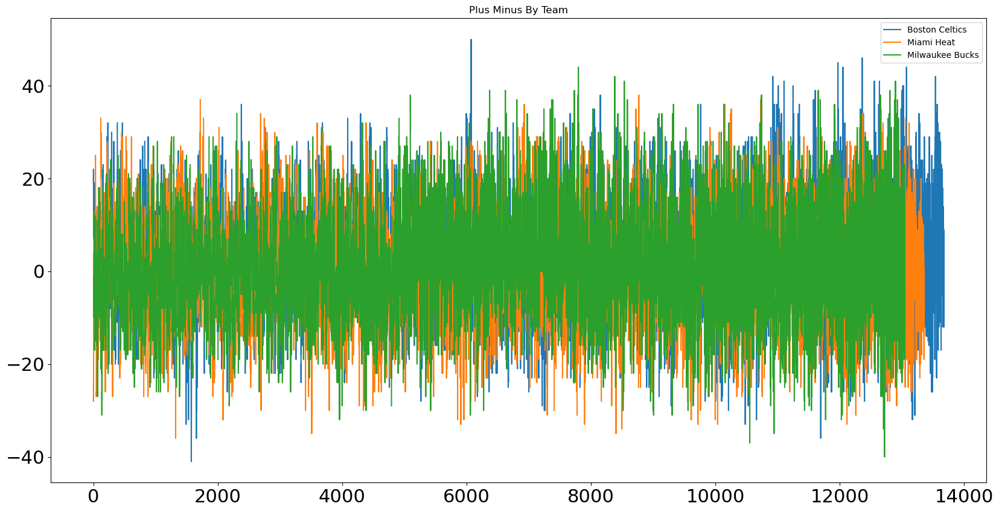

In [66]:
df[df['team_name'].isin({'Boston Celtics', 'Miami Heat', 'Milwaukee Bucks'})].groupby('team_name')['plusMinus'].plot(
    x=df.index.year, legend=True, figsize=(20, 10), use_index=False, title="Plus Minus By Team", 
    fontsize=fontsize, zorder=3)

- Now I want to compare LeBron vs Steph Curry plusMinus score over time as a visual

player_name
LeBron James     Axes(0.125,0.11;0.775x0.77)
Stephen Curry    Axes(0.125,0.11;0.775x0.77)
Name: plusMinus, dtype: object

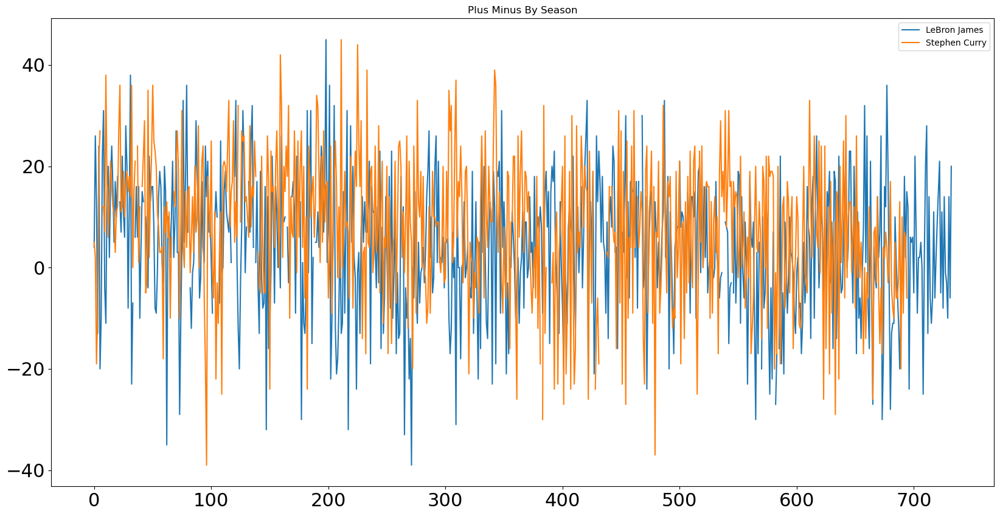

In [67]:
df[df['player_name'].isin({'LeBron James', 'Stephen Curry'})].groupby('player_name')['plusMinus'].plot(
    x=df.index.year, legend=True, figsize=(20, 10), use_index=False, title="Plus Minus By Season", 
    fontsize=fontsize, zorder=3)

- Lets try something similar with visualising season high for points scored for a less noisy plot

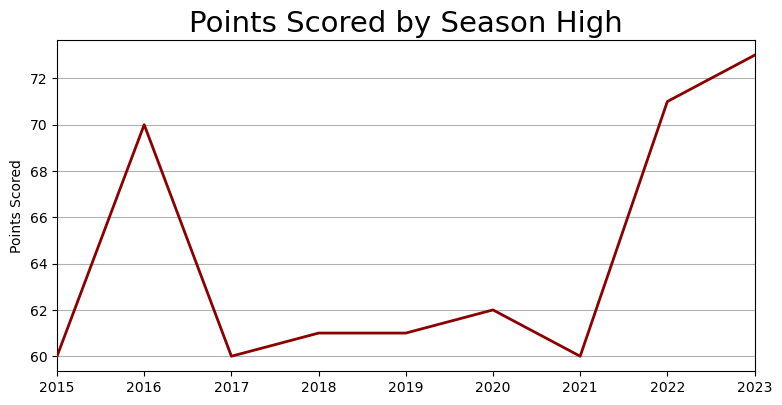

In [68]:
df_pts_per_yr = df.copy()
df_pts_per_yr.index = df_pts_per_yr.index.to_timestamp()

df_pts_per_yr = df_pts_per_yr['points'].resample("1YE").max()
ax = create_ts_plot(df_pts_per_yr, "Points Scored by Season High", "Points Scored", "darkred")

- Standout performances were on the up in 2023 with a season high 73 points (60-73pts was range for 9 years season high)
- Lets do the same for assists

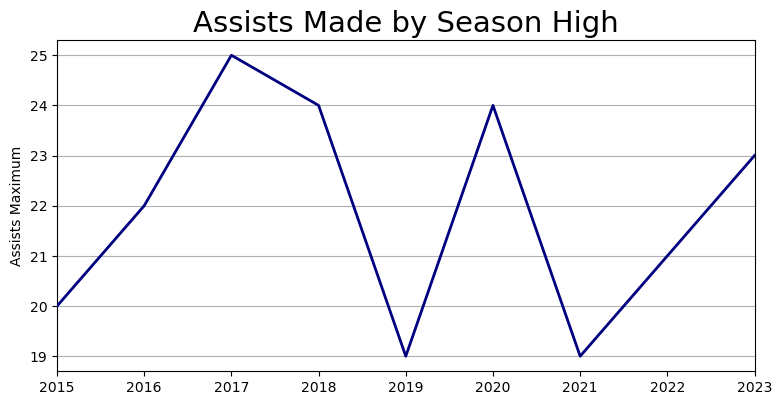

In [69]:
df_assts_per_yr = df.copy()
df_assts_per_yr.index = df_assts_per_yr.index.to_timestamp()

df_assts_per_yr = df_assts_per_yr['assists'].resample("1YE").max()
ax = create_ts_plot(df_assts_per_yr, "Assists Made by Season High", "Assists Maximum")

- 25 assists in a single game was the peak in the past 9 seasons
- The range for season high assists in a single game was [19, 25]
- Lets see the players that achieved these numbers

In [70]:
df[['player_name', 'assists']].sort_values(by='assists', ascending=False)[0:9]

,player_name,assists
season,,
2017,Rajon Rondo,25.0
2020,Russell Westbrook,24.0
2020,Russell Westbrook,24.0
2018,Russell Westbrook,24.0
2018,Russell Westbrook,24.0
2023,Tyrese Haliburton,23.0
2016,Russell Westbrook,22.0
2016,Russell Westbrook,22.0
2020,Russell Westbrook,21.0


- Russell Westbrook remarkably appearing 6 times for this milestone

- Lets take another view at points scored, instead of viewing by season high lets make a box plot to see the avergae, median, outliers

/var/folders/90/vm59v1w170n_62vbrwvd6m100000gn/T/ipykernel_68283/1739462947.py:7: UserWarning:

The palette list has more values (10) than needed (9), which may not be intended.



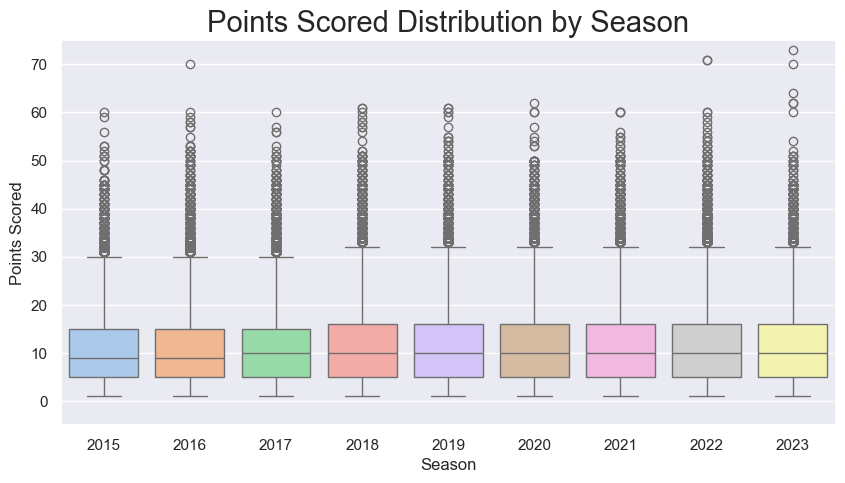

In [71]:
df_pts_high = df.loc[~((df['points'] == 0) | (df['points'].isna()))]
  
sns.set_theme(style="darkgrid")
palette = load_cmap("pastel").hex

plt.figure(figsize=(10, 5))
sns.boxplot(data=df_pts_high, x=df_pts_high.index, y='points', palette=palette, hue='season')
plt.title("Points Scored Distribution by Season", fontsize=fontsize-1)
plt.xlabel("Season")
plt.ylabel("Points Scored");
plt.ylim(-5, 75);

- Again this confirms 22/23' were strong seasons for scoring after lows in 2020/21' (`Note:` 2020/2021 was a shortened season for the covid bubble where lakers won the championship 2020 championship followed by the Bucks in 2021)
- Luka Doncic max for 2023 at 73 pts is the top scoring game over the past 9 years
- Giannis also has his franchise record for the Bucks as a notable outlier in the box plot above and summary table below
- Devin Bookers 70 point game in 2016 is a notable outlier from 2015 all the way up to 2022/2023 when single game scoring started to see some further outliers
- The median generally falling between 5-9 points.
- The bulk of player point totals per game falling between 5 and 15 points

In [72]:
df[['player_name', 'points']].sort_values(by='points', ascending=False)[0:6]# Highest single game scorers in the past 9 years

,player_name,points
season,,
2023,Luka Doncic,73.0
2022,Donovan Mitchell,71.0
2022,Damian Lillard,71.0
2023,Joel Embiid,70.0
2016,Devin Booker,70.0
2023,Giannis Antetokounmpo,64.0


- Lets get the descriptive statitics for points and assists over 9 seasons
- We can see the inter quartile range, min, max, standard deviation and averages for the whole data set which again confirms some of the previous analysis

In [73]:
round(df[['points', 'assists']].describe(), 2)

,points,assists
count,351753.00,351753.00
mean,9.19,1.99
std,8.43,2.45
min,0.00,0.00
25%,2.00,0.00
50%,8.00,1.00
75%,14.00,3.00
max,73.00,25.00


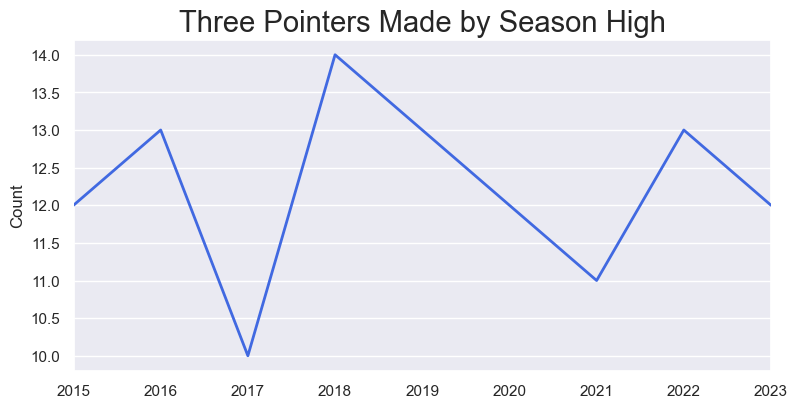

In [74]:
df_tpm_per_yr = df.copy()
df_tpm_per_yr.index = df_tpm_per_yr.index.to_timestamp()
# df_tpm_per_yr.index = [dt.datetime.strptime(date, '%m/%d/%Y').date() for date in df_tpm_per_yr.index]

df_tpm_per_yr = df_tpm_per_yr['tpm'].resample("1YE").max()
ax = create_ts_plot(df_tpm_per_yr, "Three Pointers Made by Season High", "Count", "royalblue")

- Lets take a look at the players that made the most 3-pointers in a single game

In [75]:
df[['player_name', 'tpm']].sort_values(by='tpm', ascending=False)[0:6]

,player_name,tpm
season,,
2018,Klay Thompson,14.0
2022,Damian Lillard,13.0
2019,Zach LaVine,13.0
2016,Stephen Curry,13.0
2023,Keegan Murray,12.0
2022,Klay Thompson,12.0


- The same analysis for three pointers made in a single game (season high) throws up some interesting results
- Klay Thompsons 14 3pointers remains the peak for the last 9 seasons which means perhaps field goals and free throws made up a lot of the high scoring games mentioned earlier
- The game specific stats are available from another end-point which may be worth adding as a next step to this analysis

- Next, Create function to calculate productivity matrix to generate heat maps and charts for top players in the NBA over the last 9 seasons
- This matrix needs to normalise all numeric features to the range [0, 1]
- I am adding some filters related to minutes played, fouls and turnovers to rule out some players that may not have contributed well over a longer time period (rookies, players injured for long duration etc.) with notable drawbacks to their individual performance.

In [76]:
cols_pos = ['assists', 'blocks', 'steals', 'fgm', 'fgp', 'ftm', 'ftp', 'totReb', 'tpm', 'tpp', 'points', 'min', 'plusMinus']
cols_neg = ['pFouls', 'turnovers', 'min']


def calc_productivity_matrix(df_temp, cols, min_thresh = 0.75):
    # group by player and get mean / averages for 2015-2023 (9 years)
    df_prod = df_temp.groupby("player_name")[cols].mean()

    # min-max normalisation of data frame
    df_norm_prod = (df_prod - df_prod.min()) / (df_prod.max() - df_prod.min())

    # drop records with NA values
    df_prod_heatmap = round(df_norm_prod.dropna(), 2)
    
    # filter out players with less playing experience
    if 'min' in df_prod_heatmap.columns:
        df_prod_heatmap = df_prod_heatmap[df_prod_heatmap['min'] > min_thresh]

    # calculate row sum as a sort of productivity indicator (can be based on positive or negative contributions)
    df_prod_heatmap['player_sum'] = df_prod_heatmap.sum(axis=1)

    # sort and find top 15 players
    df_prod_heatmap = df_prod_heatmap.sort_values('player_sum', ascending=False)[0:24]
    return df_prod_heatmap[cols]

- View matrix of players making a strongly positive impact for their teams

In [77]:
positive_prod = calc_productivity_matrix(df, cols_pos)
positive_prod

,assists,blocks,steals,fgm,fgp,ftm,ftp,totReb,tpm,tpp,points,min,plusMinus
player_name,,,,,,,,,,,,,
James Harden,0.95,0.14,0.39,0.79,0.43,0.96,0.84,0.52,0.71,0.35,0.95,0.94,0.59
Luka Doncic,0.87,0.10,0.29,0.96,0.46,0.76,0.72,0.69,0.64,0.33,1.00,0.97,0.54
Stephen Curry,0.64,0.06,0.36,0.90,0.47,0.58,0.83,0.42,1.00,0.41,0.97,0.89,0.66
Kevin Durant,0.56,0.28,0.21,0.95,0.53,0.74,0.86,0.57,0.47,0.40,0.97,0.96,0.65
Joel Embiid,0.37,0.36,0.21,0.87,0.49,1.00,0.80,0.87,0.24,0.30,0.94,0.91,0.61
LeBron James,0.85,0.16,0.32,0.99,0.52,0.57,0.69,0.65,0.42,0.33,0.93,0.93,0.58
Giannis Antetokounmpo,0.58,0.29,0.30,0.96,0.54,0.80,0.67,0.87,0.17,0.24,0.93,0.88,0.59
Damian Lillard,0.73,0.07,0.24,0.83,0.43,0.80,0.87,0.35,0.72,0.35,0.94,0.94,0.55
Trae Young,1.00,0.03,0.26,0.80,0.42,0.82,0.82,0.28,0.56,0.33,0.89,0.93,0.49


- View matrix of players that have a bias/weight against the positive contributions they make (fouls and turnovers can be costly especially on a regular basis)

In [78]:
negative_prod = calc_productivity_matrix(df, cols_neg)
negative_prod

,pFouls,turnovers,min
player_name,,,
James Harden,0.43,1.00,0.94
Luka Doncic,0.37,0.92,0.97
Joel Embiid,0.51,0.78,0.91
Trae Young,0.30,0.97,0.93
Cade Cunningham,0.48,0.82,0.87
Giannis Antetokounmpo,0.51,0.76,0.88
LaMelo Ball,0.50,0.75,0.88
Devin Booker,0.48,0.69,0.94
Julius Randle,0.51,0.66,0.92


- View heatmap with annotations of positive player productivity 
- Dark squares map to low scores and pale squares map to higher ranking annotation or score for the given player/feature

<Axes: ylabel='player_name'>

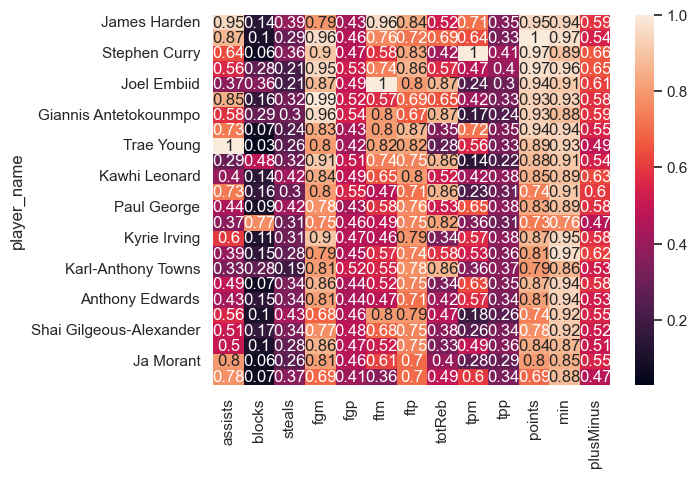

In [79]:
sns.heatmap(positive_prod, annot=True)

- View heatmap with annotations of negative player productivity 

<Axes: ylabel='player_name'>

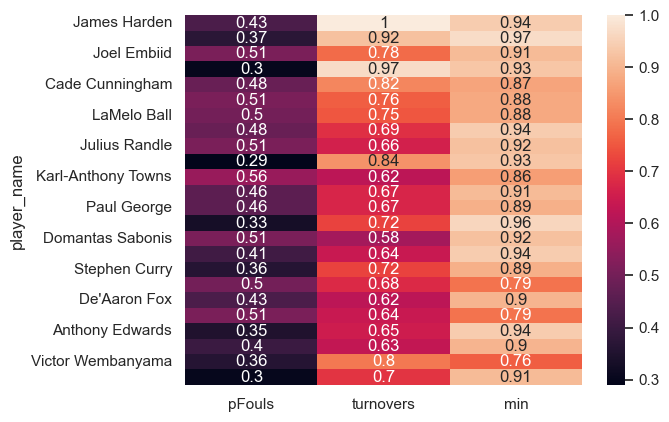

In [80]:
sns.heatmap(negative_prod, annot=True)

- We can see James Harden has a very high turnover rate along with Luka Doncic and Trae Young
- Luka, Joel and Giannis have a high combined rate of personal fouls commited coupled with turnovers
- Karl-Anthony Towns ranks highly for personal fouls committed
- Next, lets use the players appearing high up in the list for turnovers/personal fouls as another layer of selection criteria that we can use to exclude players from the top team players in the NBA over the past 9 years

In [81]:
players_to_exclude = positive_prod.index.intersection(negative_prod.index)
players_to_exclude

Index(['James Harden', 'Luka Doncic', 'Stephen Curry', 'Kevin Durant',
       'Joel Embiid', 'LeBron James', 'Giannis Antetokounmpo', 'Trae Young',
       'Nikola Jokic', 'Paul George', 'Victor Wembanyama',
       'Karl-Anthony Towns', 'Donovan Mitchell', 'Anthony Edwards',
       'LaMelo Ball'],
      dtype='object', name='player_name')

- Lets view the heat map table after excluding players with some drawbacks to their general play/performance (fouls & turnovers, not enough playing time etc.)
- `James Harden`, `Luka Doncic`, `Kevin Durant`, `Joel Embiid`, `LeBron James`, `Giannis Antetokounmpo`, `Trae Young`, `Nikola Jokic`, and `Paul George` all lose out here and are all household names in the NBA

In [82]:
df_team_pos_players = positive_prod[~positive_prod.index.isin(players_to_exclude)]
df_team_pos_players

,assists,blocks,steals,fgm,fgp,ftm,ftp,totReb,tpm,tpp,points,min,plusMinus
player_name,,,,,,,,,,,,,
Damian Lillard,0.73,0.07,0.24,0.83,0.43,0.80,0.87,0.35,0.72,0.35,0.94,0.94,0.55
Anthony Davis,0.29,0.48,0.32,0.91,0.51,0.74,0.75,0.86,0.14,0.22,0.88,0.91,0.54
Kawhi Leonard,0.40,0.14,0.42,0.84,0.49,0.65,0.80,0.52,0.42,0.38,0.85,0.89,0.63
Kyrie Irving,0.60,0.11,0.31,0.90,0.47,0.46,0.79,0.34,0.57,0.38,0.87,0.95,0.58
Jayson Tatum,0.39,0.15,0.28,0.79,0.45,0.57,0.74,0.58,0.53,0.36,0.81,0.97,0.62
Jimmy Butler,0.56,0.10,0.43,0.68,0.46,0.80,0.79,0.47,0.18,0.26,0.74,0.92,0.55
Shai Gilgeous-Alexander,0.51,0.17,0.34,0.77,0.48,0.68,0.75,0.38,0.26,0.34,0.78,0.92,0.52
Bradley Beal,0.50,0.10,0.28,0.86,0.47,0.52,0.75,0.33,0.49,0.36,0.84,0.87,0.51
Ja Morant,0.80,0.06,0.26,0.81,0.46,0.61,0.70,0.40,0.28,0.29,0.80,0.85,0.55


- This is the final elite group, I would like to display further information about these players

In [83]:
df_elite_players = df[df['player_name'].isin(df_team_pos_players.index)][['player_name', 'team_name', 'active', 'years_pro', 'affiliation', 'college', 'country', 'age', 'rookie_year']].reset_index(drop=True).drop_duplicates().sort_values('player_name')

# df_team_pos_players.fillna(0)
# df_team_pos_players = np.nan_to_num(df_team_pos_players)
df_elite_players = df_elite_players.loc[~((df_elite_players['years_pro'] == 0) | (df_elite_players['years_pro'].isna()))]
df_elite_players['years_pro'] = df_elite_players['years_pro'].astype('int')
df_elite_players['age'] = df_elite_players['age'].astype('int')
df_elite_players['rookie_year'] = df_elite_players['rookie_year'].astype('int')
df_elite_players

,player_name,team_name,active,years_pro,affiliation,college,country,age,rookie_year
0,Anthony Davis,New Orleans Pelicans,True,9,Kentucky/USA,Kentucky,USA,31,2012
2937,Anthony Davis,Los Angeles Lakers,True,9,Kentucky/USA,Kentucky,USA,31,2012
392,Bradley Beal,Washington Wizards,True,9,Florida/USA,Florida,USA,31,2012
5589,Bradley Beal,Phoenix Suns,True,9,Florida/USA,Florida,USA,31,2012
175,Damian Lillard,Portland Trail Blazers,True,9,Weber State/USA,Weber State,USA,34,2012
5268,Damian Lillard,Milwaukee Bucks,True,9,Weber State/USA,Weber State,USA,34,2012
1500,Jayson Tatum,Boston Celtics,True,4,Duke/USA,Duke,USA,26,2017
483,Jimmy Butler,Chicago Bulls,True,10,Marquette/USA,Marquette,USA,35,2011
2975,Jimmy Butler,Miami Heat,True,10,Marquette/USA,Marquette,USA,35,2011
1333,Jimmy Butler,Minnesota Timberwolves,True,10,Marquette/USA,Marquette,USA,35,2011


- We can see all players are active, the teams they have represented (most recent record is where index value is highest), country and college info, age and when they turned professional.
- `Stephen Curry` is the oldest and most experienced player in this group followed by Damian Lillard.
- We can see `Jayson Tatum & Stephen Curry` are loyal players as they have stayed with the team the drafted them to this point.
- Kyrie Irving is the only non-americans in the list.
- This is a bit messy for players that have represented more than one team in the 9 year timeframe so lets get the most recent team information for each of these players only (to reduce the noise / record count).

In [84]:
df_elite_players.sort_index(axis=0, ascending=False).groupby('player_name').first()

,team_name,active,years_pro,affiliation,college,country,age,rookie_year
player_name,,,,,,,,
Anthony Davis,Los Angeles Lakers,True,9,Kentucky/USA,Kentucky,USA,31,2012
Bradley Beal,Phoenix Suns,True,9,Florida/USA,Florida,USA,31,2012
Damian Lillard,Milwaukee Bucks,True,9,Weber State/USA,Weber State,USA,34,2012
Jayson Tatum,Boston Celtics,True,4,Duke/USA,Duke,USA,26,2017
Jimmy Butler,Miami Heat,True,10,Marquette/USA,Marquette,USA,35,2011
Kawhi Leonard,LA Clippers,True,10,San Diego State/USA,San Diego State,USA,33,2011
Kyrie Irving,Dallas Mavericks,True,10,Duke/Australia,Duke,Australia,32,2011


- Now we see one record for each player and only for the team they currently represent
- `Jayson Tatum` has time on his side to improve his rankings as all the other players are professionals for 9 years or longer

- Lets view the productivity table as a heatmap to help identify where each player excels
- The darker the cell background, the better or the higher the player ranking for the given feature used for analysis

In [85]:
df_team_pos_players.style.background_gradient(cmap='Blues')

,assists,blocks,steals,fgm,fgp,ftm,ftp,totReb,tpm,tpp,points,min,plusMinus
player_name,,,,,,,,,,,,,
Damian Lillard,0.730000,0.070000,0.240000,0.830000,0.430000,0.800000,0.870000,0.350000,0.720000,0.350000,0.940000,0.940000,0.550000
Anthony Davis,0.290000,0.480000,0.320000,0.910000,0.510000,0.740000,0.750000,0.860000,0.140000,0.220000,0.880000,0.910000,0.540000
Kawhi Leonard,0.400000,0.140000,0.420000,0.840000,0.490000,0.650000,0.800000,0.520000,0.420000,0.380000,0.850000,0.890000,0.630000
Kyrie Irving,0.600000,0.110000,0.310000,0.900000,0.470000,0.460000,0.790000,0.340000,0.570000,0.380000,0.870000,0.950000,0.580000
Jayson Tatum,0.390000,0.150000,0.280000,0.790000,0.450000,0.570000,0.740000,0.580000,0.530000,0.360000,0.810000,0.970000,0.620000
Jimmy Butler,0.560000,0.100000,0.430000,0.680000,0.460000,0.800000,0.790000,0.470000,0.180000,0.260000,0.740000,0.920000,0.550000
Shai Gilgeous-Alexander,0.510000,0.170000,0.340000,0.770000,0.480000,0.680000,0.750000,0.380000,0.260000,0.340000,0.780000,0.920000,0.520000
Bradley Beal,0.500000,0.100000,0.280000,0.860000,0.470000,0.520000,0.750000,0.330000,0.490000,0.360000,0.840000,0.870000,0.510000
Ja Morant,0.800000,0.060000,0.260000,0.810000,0.460000,0.610000,0.700000,0.400000,0.280000,0.290000,0.800000,0.850000,0.550000


- We can already see a pattern emerging for the order of the list, tpp (three-point percentage), points and plusMinus are basically going from a paler square or light blue to navy as we go to the top of the list with Stephen Curry.
- Lets try this in a Seaborn line plot instead to see if there are any other obvious patterns
- Heat Maps (Numbers/Annotations/Cell colours etc.) sometimes dont show the obvious gap in some areas

(array([0. , 0.2, 0.4, 0.6, 0.8, 1. , 1.2]),
 [Text(0, 0.0, '0.0'),
  Text(0, 0.2, '0.2'),
  Text(0, 0.4, '0.4'),
  Text(0, 0.6000000000000001, '0.6'),
  Text(0, 0.8, '0.8'),
  Text(0, 1.0, '1.0'),
  Text(0, 1.2000000000000002, '1.2')])

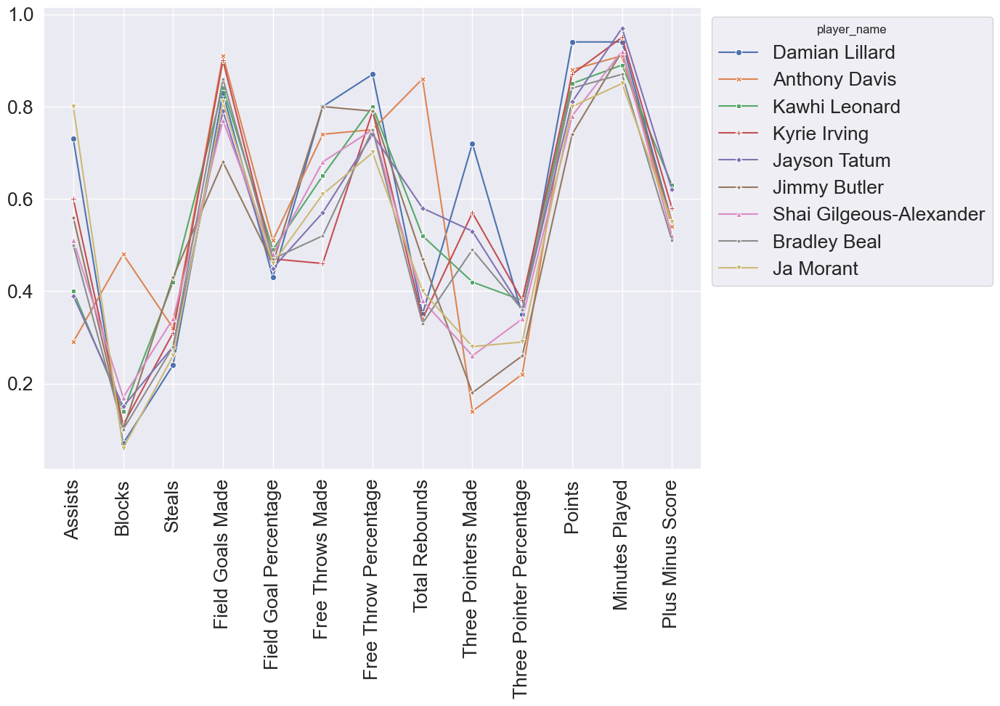

In [86]:
a4_dims= [11.7, 8.27]
fig, ax = plt.subplots(figsize=a4_dims)
df_team_pos_players = df_team_pos_players.rename(columns={'assists': 'Assists',
                                                          'blocks': 'Blocks',
                                                          'steals': 'Steals',
                                                          'fgm' : 'Field Goals Made',
                                                          'fgp' : 'Field Goal Percentage',
                                                          'ftm' : 'Free Throws Made',
                                                          'ftp' : 'Free Throw Percentage',
                                                          'totReb' : 'Total Rebounds',
                                                          'tpm' : 'Three Pointers Made',
                                                          'tpp' : 'Three Pointer Percentage',
                                                          'points': 'Points',
                                                          'min': 'Minutes Played',
                                                          'plusMinus': 'Plus Minus Score'})
ax = sns.lineplot(ax=ax, data=df_team_pos_players.T, markers=True, dashes=False)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1,1), fontsize=19)
plt.xticks(rotation = "vertical", fontsize=19)
plt.yticks(fontsize=19)

- We can now see `Steph Curry` is in a league of his own for three point shooting (Blue line peak right of middle)
- While `Damian Lillard` is tops for Assists and Free Throws at the elite level (Orange Line), which also means he is very good a drawing fouls from the opposition (something not obvious in stats except for plus minus score or something more generic)
- `Steph Curry` peaks again for Points, a natural scorer
- `Steph Curry` has a low for blocks, while `Anthony Davis` is particularly weak on Three Pointers but very strong in rebounding and blocks.

- Anthony Davis is a ntoable shot blocker here (green line).
    - This is interesting because, through previous analysis, the latest number 1 draft pick has a similar trajectory to `Anthony Davis` because they are both extremely good shot blockers and rebounders, However, `Victor Wembanyama` of `France` has the ability to shoot well from three point range and possibly peform even better in relation to assists and blocks.
- I want to view this theory by displaying AD against Victor in this format (Experience Vs Youth).

(array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 [Text(0, 0.1, '0.1'),
  Text(0, 0.2, '0.2'),
  Text(0, 0.30000000000000004, '0.3'),
  Text(0, 0.4, '0.4'),
  Text(0, 0.5, '0.5'),
  Text(0, 0.6, '0.6'),
  Text(0, 0.7000000000000001, '0.7'),
  Text(0, 0.8, '0.8'),
  Text(0, 0.9, '0.9'),
  Text(0, 1.0, '1.0')])

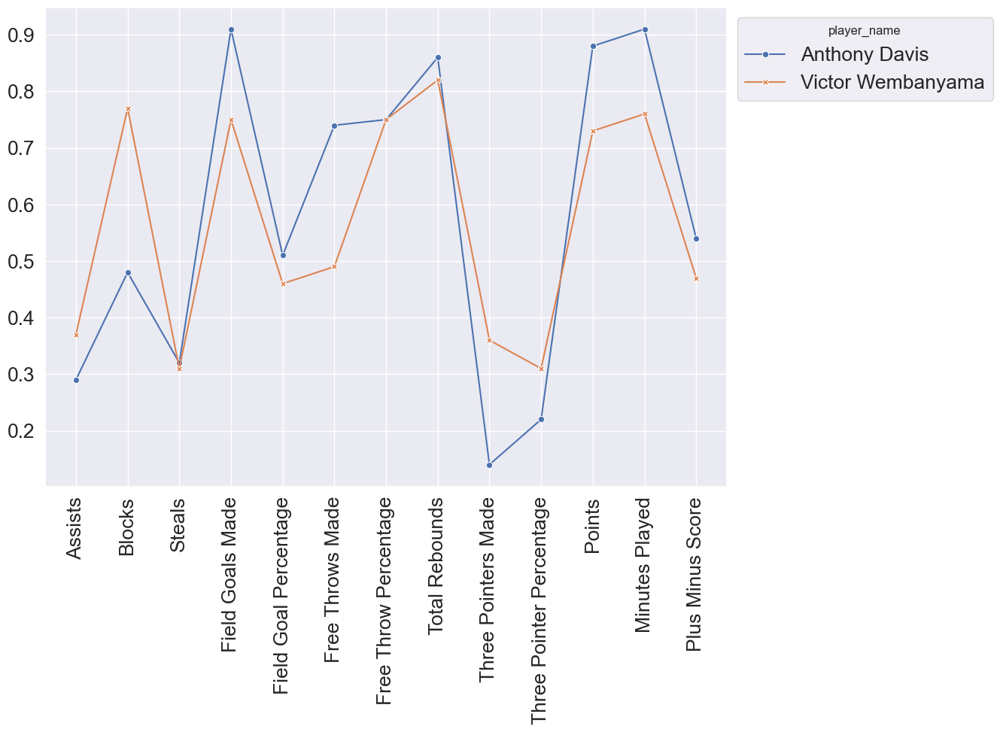

In [87]:
df_matrix_70 = calc_productivity_matrix(df, cols_pos, min_thresh=0.7)# lower minustes played threshold to pull in less experienced pros and rookies that are performing well
df_victor_ad = df_matrix_70[df_matrix_70.index.isin(['Victor Wembanyama', 'Anthony Davis'])]
a4_dims= [11.7, 8.27]
fig, ax = plt.subplots(figsize=a4_dims)
df_victor_ad = df_victor_ad.rename(columns={'assists': 'Assists',
                                                          'blocks': 'Blocks',
                                                          'steals': 'Steals',
                                                          'fgm' : 'Field Goals Made',
                                                          'fgp' : 'Field Goal Percentage',
                                                          'ftm' : 'Free Throws Made',
                                                          'ftp' : 'Free Throw Percentage',
                                                          'totReb' : 'Total Rebounds',
                                                          'tpm' : 'Three Pointers Made',
                                                          'tpp' : 'Three Pointer Percentage',
                                                          'points': 'Points',
                                                          'min': 'Minutes Played',
                                                          'plusMinus': 'Plus Minus Score'})
ax = sns.lineplot(ax=ax, data=df_victor_ad.T, markers=True, dashes=False)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1,1), fontsize=19)
plt.xticks(rotation = "vertical", fontsize=19)
plt.yticks(fontsize=19)



- Overall, we can see ADs experience shines through but very promising stats so far from the latest #1 draft pick

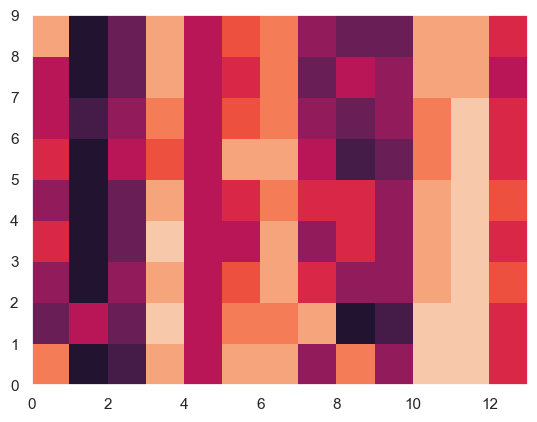

In [88]:
plt.pcolor(df_team_pos_players)

- We can see how yellow matches up with the pale colours below and navy above matches closely to black or low ranking squares below
- The annotations and index labelling really is helpful for decoding and making sense of this visualisation though so it is important to try different libraries/packages when possible like plotly, mathplotlib, Seaborn, Bokeh etc.
- Seaborn on this occasion is a better visual with more information packed in automatically, I like because it is easy to use.

<Axes: ylabel='player_name'>

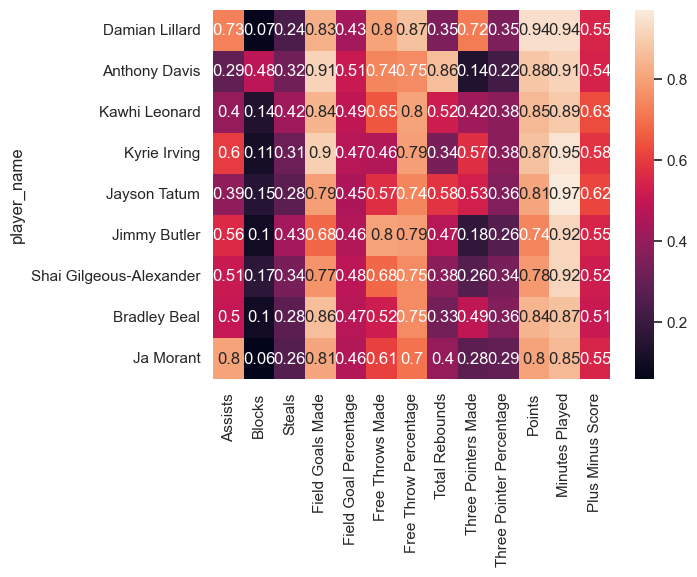

In [89]:
sns.heatmap(df_team_pos_players, annot=True)

- After messing around with different visuals of this final elite group of players, I think an interactive stacked bar chart might be the best option for this data overall.
- Lets view each players bar chart first after we set a color for each statistic type

In [90]:
stat_cols = ['Assists', 'Blocks', 'Steals', 'Field Goals Made', 'Field Goal Percentage', 'Free Throws Made', 
             'Free Throw Percentage', 'Total Rebounds', 'Three Pointers Made', 'Three Pointer Percentage', 'Points',
             'Minutes Played', 'Plus Minus Score']
colours = ["limegreen", "red", "navy", "lightblue", "darkorange", "pink", "lightgreen", "orange", "darkgreen",
           "purple", "blue", "darkred", "yellow"]

stats_colours = dict(zip(stat_cols, colours))
stats_colours

{'Assists': 'limegreen',
 'Blocks': 'red',
 'Steals': 'navy',
 'Field Goals Made': 'lightblue',
 'Field Goal Percentage': 'darkorange',
 'Free Throws Made': 'pink',
 'Free Throw Percentage': 'lightgreen',
 'Total Rebounds': 'orange',
 'Three Pointers Made': 'darkgreen',
 'Three Pointer Percentage': 'purple',
 'Points': 'blue',
 'Minutes Played': 'darkred',
 'Plus Minus Score': 'yellow'}

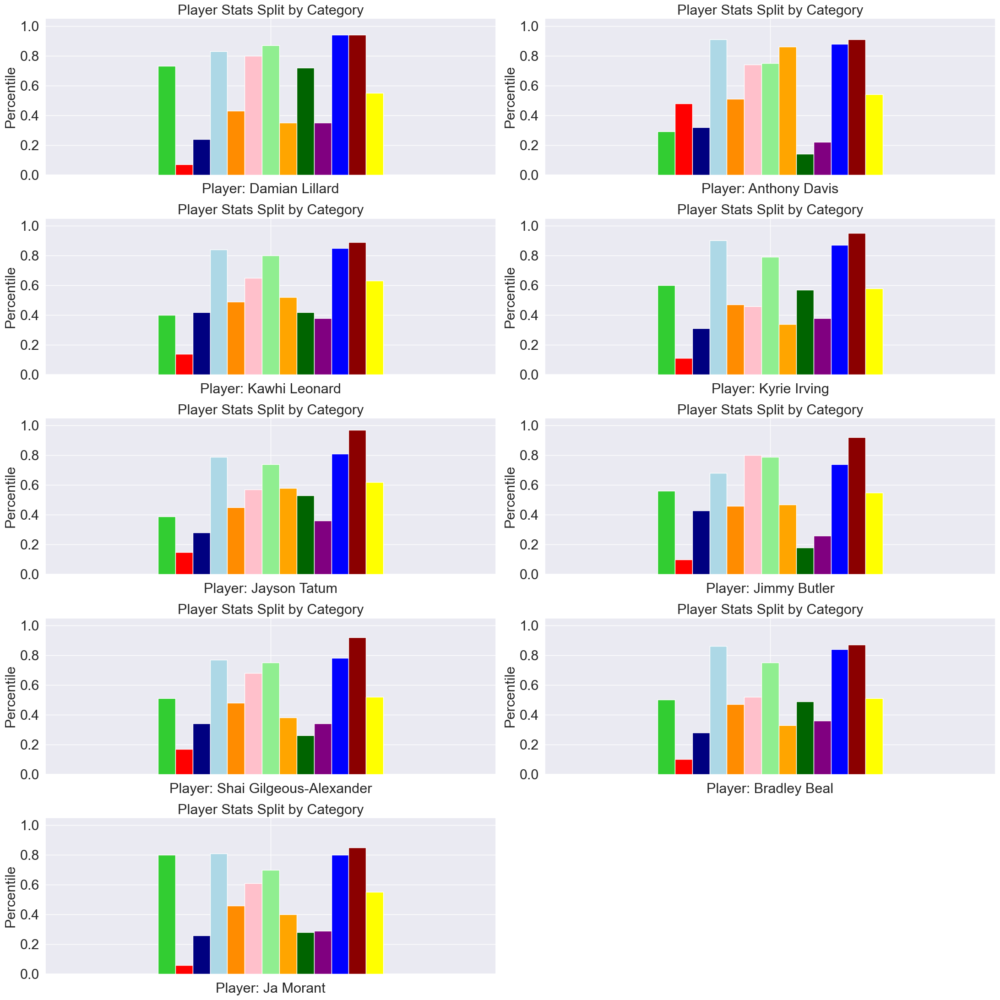

In [91]:
fig = plt.figure(figsize=(22, 22))
for i, player in enumerate(df_team_pos_players.index):
    # create the sub plot
    axc = fig.add_subplot(5, 2, i+1)
    ax = df_team_pos_players[df_team_pos_players.index == player].plot.bar(ax=axc, 
                                                                           legend=False,
                                                                           y=stat_cols, 
                                                                           color=stats_colours, 
                                                                           fontsize=fontsize, 
                                                                           zorder=3)
    # configure axis ticks / labels
    xticklabels = ""
    ax.xaxis.set_major_formatter(ticker.FixedFormatter(xticklabels))
    ax.set_title("Player Stats Split by Category", fontsize=fontsize)
    ax.set_xlabel("Player: %s" % player, fontsize=fontsize)
    ax.set_ylabel("Percentile", fontsize=fontsize)
    ax.set_ylim([.0, 1.05])
    ax.yaxis.grid=True;
fig.tight_layout()                                               

- Lets merge this visualisation into one interactive plot

In [92]:
result_bc = df_team_pos_players.plot(backend='plotly', kind='bar', labels=dict(variable='Stat Category', 
                                                                               value='Normalised Proportion of Productivity'))
result_bc.layout.xaxis.title.text = 'Player Name'
result_bc

- We can now see that Stephen Curry and Damian Lillard are particularly strong on three point shooting, Steph & Anthony Davis (AD) for Field Goals Made, AD for Rebounding, Damian Lillard for assists, and AD for Blocks.
- This `visual helps decode where the top players are particularly strong and possible areas of improvement`.
- This is strong evidence for players that are within or atleast close to the top 10 performing players in the NBA over the last 9 seasons
- Notably the minutes played, points, plusMinus score, steals, and FTP (free throw percentage) area of bars is similar for all players in this group.
- `Three pointers, assists, blocks and rebounds` are key areas of differentiation at the top end of the NBA judging by this visual.

### 3. Discussion

- The data used is spread across `2 different endpoints` with a limitation that only data from the years `2015-2023` is available. The volume of data involved is still quite substantial at `more than 309,000 records`.
- The data used is from `540` API requests and there was a lot of time trying to pre-process and merge this data into something useful via player ID and other features.
- There was a lot of `nested JSON objects` that had features I needed to extract, parse and format into something useful for the analysis here.
- There were other difficulties such as `missing Country and College` information etc. for rookies or lesser known players such as Victor Wembanyama so the API covers a lot and is being updated all the time but is not perfect.
- Data verification tasks included searching online for the single game records for points, assists, and three pointers made in the past 9 years. In addition, I completed some verification of the data actually loaded into the notebook along with some other spot checks (ongoing task for data of this nature as it is being updated all the time).
- The key insights were the `top players by statistic` (total and averges) for certain stats in the NBA along with the final stacked bar chart and heatmaps which help identify some of the `most productive and high performing players` over the last `9 years`.

- I was able to track down a group of players that represent an `elite group that best contributed to their respective teams over a 9 year period` (all stars with 2 players (Damian Lillard & Jayson Tatum) that have yet to win a championship ring but have featured in several playoff series and all star weekends etc.).

- I think the next step would be to pull `game data and statistics` by game ID. We could then use this in combination with player ID and team ID (as some players have moved / were traded to several different teams over the years) to merge this data into the main DataFrame to get an idea of the win rate associated with the players here and the split of `regular season statistics vs playoff games`. 

- I would like to also see how player performance varies from one franchise to another, such as `LeBron at Miami vs LeBron at the Lakers`. 

- Right now it is hard to see which data is regular or post season and what players do not perform well in the playoffs vs regular season games. This would be another key insight to try visualise, perhaps more important than the average 'plusMinus' score or the method I have used to find the most impactful NBA players over the last 9 seasons.

- I think a view of the final stacked bar chart per season would allow to see what players are trending up and what players are trending down in their performance levels. This may show that I wrongly excluded players like: `James Harden`, `Luka Doncic`, `Kevin Durant`, `Joel Embiid`, `LeBron James`, `Giannis Antetokounmpo`, `Trae Young`, `Nikola Jokic`, and `Paul George` from the final elite players group for the past 9 years. However, from the players excluded, `Durant, LeBron, Giannis and Nikola` are the players to be part of a winning championship team. To that end, `Gianis` and `Nikola Jokic` are under 30, while `LeBron` and `Kevin Durant` are 39 & 35 years of age respectively. 